#### Initialize

In [1]:
push!(LOAD_PATH, joinpath(@__DIR__, "src")) 
using Measurements
using Statistics
using DataFrames
using Plots
using Revise
using LineCableModels

# VS Code / Jupyter string formatting
struct PlainString
    str::String
end

Base.show(io::IO, ::MIME"text/plain", ps::PlainString) = print(io, ps.str)

# Initialize plotlyjs backend
plotlyjs()  

# Font size configuration
base_font_size = 12
title_base_font_size = 14
leg_base_font_size = 10

# Set default font globally
default(
    fontfamily = "Computer Modern",
    guidefontsize = base_font_size,   # Axis labels (x/y/z)
    tickfontsize = base_font_size,    # Tick labels
    titlefontsize = title_base_font_size, # Title font size
    legendfontsize = leg_base_font_size  # Legend font size
)

##### Define project ID

In [2]:
project_id = "single_core_1000mm2_1830"
output_dir = joinpath(@__DIR__, "projects", project_id)
mkpath(output_dir)
push!(LOAD_PATH, output_dir);

#### Materials library

In [3]:
materials_db = MaterialsLibrary(file_name=joinpath(output_dir, "materials_library.csv"))
display_materials_library(materials_db)

No /home/amartins/Documents/KUL/LineCableModels/projects/single_core_1000mm2_1830/materials_library.csv found. Initializing default materials database...


Row,name,rho,eps_r,mu_r,T0,alpha
,String,Float64,Float64,Float64,Float64,Float64
1,pe,1.97e14,2.3,1.0,20.0,0.0
2,polyacrylate,5300.0,32.3,1.0,20.0,0.0
3,semicon1,1000.0,1000.0,1.0,20.0,0.0
4,copper,1.7241e-8,1.0,0.999994,20.0,0.00393
5,xlpe,1.97e14,2.5,1.0,20.0,0.0
6,pec,2.22045e-16,1.0,1.0,20.0,0.0
7,air,Inf,1.0,1.0,20.0,0.0
8,semicon2,500.0,1000.0,1.0,20.0,0.0
9,aluminum,2.8264e-8,1.0,1.00002,20.0,0.00429


#### Cable design

In [ ]:
cable_id = "NA2XS(FL)2Y18/30"

library = CablesLibrary(file_name = joinpath(output_dir, "cables_library.jls"))
display_cables_library(library)

if haskey(library.cable_designs, cable_id) # Design already exists
	cable_design = get_cable_design(library, cable_id)
else 
	# Load datasheet nominal dimensions
	include("NominalDims.jl")

	# Load measurements with uncertainties, if available
	if isfile("MeasuredDims.jl")
		include("MeasuredDims.jl")
	end

	# Load measurements with uncertainties, if available
	include("CableDesign.jl")
	store_cable_design!(library, cable_design)
	save_cables_library(library, file_name = joinpath(output_dir, "cables_library.jls"))
end;


Loading cables database from /home/amartins/Documents/KUL/LineCableModels/projects/single_core_1000mm2_1830/cables_library.jls...
Cables database successfully loaded!


##### Preview

- Comparison with datasheet information:

Row,parameter,computed,nominal,lower,upper,complies?
,String,Measurem…,Float64,Float64,Float64,Bool
1,R [Ω/km],0.0347±0.009,0.0291,0.0257763,0.0436899,true
2,L [mH/km],0.3115±0.0051,0.3,0.306465,0.316608,false
3,C [μF/km],0.3939±0.0052,0.39,0.388649,0.399068,true


- EMT parameters:

Row,property,core,sheath,jacket
,Symbol,Measurem…,Measurem…,Measurem…
1,radius_in_con,0.0±0.0,0.0287103±0.0,0.0301523±0.0
2,radius_ext_con,0.0188±0.0024,0.02983±0.00031,0.030314±4.4e-5
3,rho_con,3.8741e-8±1.8e-24,9.2e-8±2.4e-8,2.8264e-8±9.2e-25
4,alpha_con,0.00429±2.4e-19,0.00393±0.0,0.00429±0.0
5,mu_con,1.03±0.43,2.3±0.57,1.00002±1.3e-15
6,radius_ext_ins,0.0287±0.0024,0.03015±0.0004,0.0337±0.00022
7,eps_ins,2.98±0.31,32.3±0.33,2.4966±0.0035
8,mu_ins,1.074±0.011,1.02651±0.00037,1.0±0.0
9,loss_factor_ins,2.86e-6±3.3e-7,2100.02±0.0,7.31025e-7±6.5e-11


- Detailed description of cable parts:

Row,property,"core, layer 1","core, layer 2","core, layer 3","core, layer 4","core, layer 5","sheath, layer 1","sheath, layer 2","jacket, layer 1","jacket, layer 2","jacket, layer 3"
,String,Any,Any,Any,Any,Any,Any,Any,Any,Any,Any
1,type,conductor,semicon,insulator,semicon,semicon,conductor,semicon,conductor,insulator,insulator
2,radius_in,0,0.0188425±0.0,0.01961±0.0,0.027915±0.0,0.0283875±0.0,0.0287103±0.0,0.0298295±0.0,0.0301523±0.0,0.0303137±0.0,0.0303637±0.0
3,radius_ext,0.0188±0.0024,0.01961±3.7e-5,0.02791±0.00013,0.028387±3.0e-5,0.02871±8.9e-5,0.02983±0.00031,0.030152±8.9e-5,0.030314±4.4e-5,0.0303637±0.0,0.0337±0.00022
4,diam_in,0,0.037685±0.0,0.03922±0.0,0.05583±0.0,0.056775±0.0,0.0574207±0.0,0.0596589±0.0,0.0603046±0.0,0.0606274±0.0,0.0607274±0.0
5,diam_ext,0.0377±0.0049,0.03922±7.4e-5,0.05583±0.00026,0.056775±6.0e-5,0.05742±0.00018,0.05966±0.00062,0.0603±0.00018,0.060627±8.9e-5,0.0607274±0.0,0.06741±0.00043
6,thickness,0.0188±0.0024,0.000768±3.7e-5,0.0083±0.00013,0.000473±3.0e-5,0.000323±8.9e-5,0.00112±0.00031,0.000323±8.9e-5,0.000161±4.4e-5,5.0e-5±0.0,0.00334±0.00022
7,cross_section,0.00084±0.00022,9.27e-5±4.6e-6,0.00124±2.3e-5,8.36e-5±5.4e-6,5.8e-5±1.6e-5,4.0e-5±2.2e-5,6.1e-5±1.7e-5,3.07e-5±8.5e-6,9.53118e-6±0.0,0.000672±4.6e-5
8,num_wires,61,missing,missing,missing,missing,49,missing,0,missing,missing
9,resistance,3.47e-5±9.0e-6,1.079e7±530000.0,1.589e17±2.9e15,5.98e6±380000.0,9.2e7±2.5e7,0.00045±0.00024,8.7e7±2.4e7,0.00092±0.00025,2.0669e19±0.0,2.93e17±2.0e16


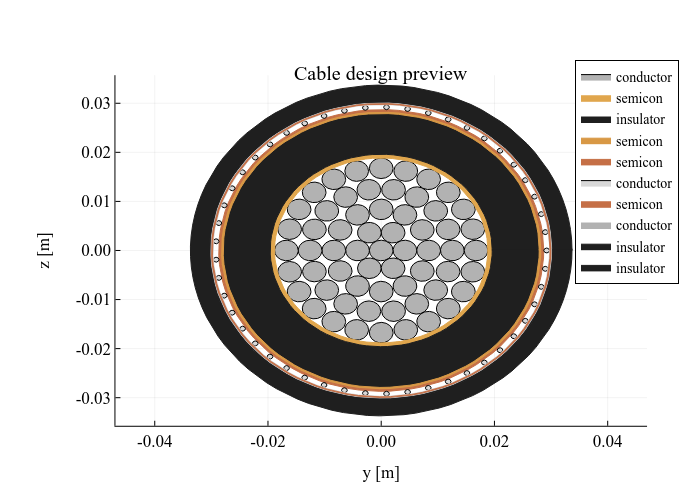

In [5]:
display(PlainString("- Comparison with datasheet information:"))
display(core_parameters(cable_design))

display(PlainString("- EMT parameters:"))
display(cable_data(cable_design))

display(PlainString("- Detailed description of cable parts:"))
display(cable_parts_data(cable_design))

preview_cable_design(cable_design)

#### Earth model with frequency-dependent properties

In [6]:
f = 10.0 .^ range(0, stop=6, length=10)
earth_params = EarthModel(f, 100.0, 10.0, 1.0)

# Optional: multi-layered earth model
# earth_params.EHEMformulation=EnforceLayer(-1)
# earth_params.layers[end].t = 2.0
# add_earth_layer!(earth_params, f, 200, 15, 1, t=Inf)

display(PlainString("- Earth model base (DC) properties:"))
display(earth_data(earth_params))

- Earth model base (DC) properties:

Row,rho_g,epsr_g,mur_g,thickness
,Float64,Float64,Float64,Float64
1,Inf,1.0,1.0,Inf
2,100.0,10.0,1.0,Inf


#### Cable system layout

- Cable system details:

Row,cable_id,horz,vert,phase_mapping
,String,Number,Number,String
1,NA2XS(FL)2Y18/30,0.0±0.0,-0.969689±0.0,"core: 1, sheath: 0, jacket: 0"
2,NA2XS(FL)2Y18/30,-0.035±0.0,-1.03031±0.0,"core: 2, sheath: 0, jacket: 0"
3,NA2XS(FL)2Y18/30,0.035±0.0,-1.03031±0.0,"core: 3, sheath: 0, jacket: 0"


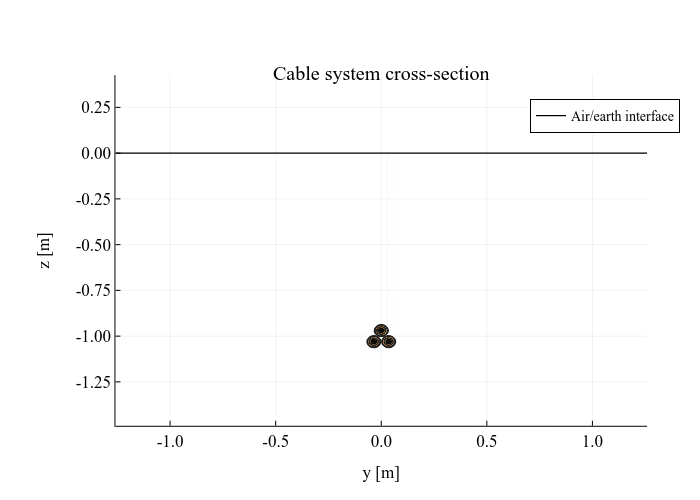

In [7]:
x0 = percent_to_uncertain(0, 0)
y0 = percent_to_uncertain(-1, 0)
xa, ya, xb, yb, xc, yc = trifoil_formation(x0, y0, 0.035)

# Initialize the LineCableSystem
cabledef1 = CableDef(cable_design, xa, ya, Dict("core" => 1, "sheath" => 0, "armor" => 0))
cable_system = LineCableSystem("test_case_1", 20.0, earth_params, 1000.0, cabledef1)
add_cable_definition!(cable_system, cable_design, xb, yb)
add_cable_definition!(cable_system, cable_design, xc, yc)

# Preview cross-section
display(PlainString("- Cable system details:"))
display(cross_section_data(cable_system))
preview_system_cross_section(cable_system, zoom_factor = .25)

#### PSCAD Export

In [8]:
export_pscad_model(cable_system, folder_path=output_dir);

File successfully created at: /home/amartins/Documents/KUL/LineCableModels/projects/single_core_1000mm2_1830/test_case_1.pscx
